# ACSE 4.3 SPH postprocessing
By Hanran Ji (hj19) & Tianzong Yu (ty616)

# 0. prerequisite & constants

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as anim
from IPython.display import HTML
import sys
import imageio
import pandas as pd
from statistics import mean

In [2]:
prefix_address='output_'
suffix_address='.vtp'
no_max=19456
time_step=0.0013
total_t=no_max*time_step
save_step=128
items=int(no_max/save_step)+1

# 1. Work streamline: Read files -> Make & fill Grid -> Get data at peak

In [3]:
def read_address(add):
    data = []
    file=open(add,"r")
    for line in file.readlines(): #read all lines; remember to change file address
        line_splitted=line.split(" ")
        data.append(line_splitted)               # append to list
    length=int(data[2][2][15:-1])
    dim=int(data[7][3][20:-1])
    Pre_list=list(map(float, data[5][1:]))
    V_list=[]
    Point_list=[]
    for i in range(dim-1):
        #Vx, Vy
        V_list.append(list(map(float, data[8][i+1::3])))
        #x and y co-or
        Point_list.append(list(map(float, data[13][i+1::3])))
    return length, dim, Pre_list, V_list, Point_list #output as raw_data

def make_grid(Point_list):
    #find range & step for gridifying
    y_range=max(Point_list[1])-min(Point_list[1])
    step=(Point_list[1][1]-Point_list[1][0])/2.
    y_grid_size=int(y_range/step)+1
    x_range=Point_list[0][-1]-Point_list[0][0]
    x_grid_size=int(x_range/step)+1
    #make a grid
    x_grid_corrected=np.array(Point_list[0])-Point_list[0][0]
    y_grid_corrected=np.array(Point_list[1])-Point_list[1][0]
    #convert cartesian co-ord to indices in grid
    x_coord_grid=(x_grid_corrected/step+0.9999).astype(int)
    y_coord_grid=(y_grid_corrected/step+0.9999).astype(int)
    #change to indices
    Vx_grid=np.empty([y_grid_size, x_grid_size])
    Vy_grid=np.empty([y_grid_size, x_grid_size])
    Pre_grid=np.empty([y_grid_size, x_grid_size])
    #output as raw_grid
    return step, y_range, y_grid_size, x_range, x_grid_size, y_coord_grid, x_coord_grid, Vx_grid, Vy_grid, Pre_grid 

    
def fill_grid(y_coord_grid,x_coord_grid, Vx_grid, Vy_grid, Pre_grid, V_list,Pre_list, length):
    #velocity_x
    Vx_grid[:]=np.NaN
    Vy_grid[:]=np.NaN
    Pre_grid[:]=np.NaN
    for i in range(length):       
        Vx_grid[y_coord_grid[i]][x_coord_grid[i]]=V_list[0][i]
        Vy_grid[y_coord_grid[i]][x_coord_grid[i]]=V_list[1][i]
        Pre_grid[y_coord_grid[i]][x_coord_grid[i]]=Pre_list[i]
    return Pre_grid, Vx_grid, Vy_grid #output as gradified

def find_peak(length,Pre_list,V_list,Point_list,tol,min_y=2):
    inner_list=[]
    for i in range(length):
        if Point_list[1][i] >min_y and Point_list[1][i] < 10 and Point_list[0][i] > 0 and Point_list[0][i] < 20:
            inner_list.append(Point_list[1][i])
        else:
            continue
#     inner_list.sort()
#     inner_list=np.array(inner_list)
#     #print(inner_list)
#     diff = inner_list[1:]-inner_list[:-1]
#     k=inner_list[0]
#     for i in range(1,len(diff)):
#         k=inner_list[i-1]
#         if diff[i] < tol:
#             #print(i,inner_list[i-1],diff[i])
#             continue
#         else: 
#             #print('cut',i,inner_list[i-1],diff[i])
#             break
    k=max(inner_list)
    peak_index=Point_list[1].index(k)
    Vx_max=V_list[0][peak_index]
    Vy_max=V_list[1][peak_index]
    Pre_max=Pre_list[peak_index]
    peak_x_coord=Point_list[0][peak_index]
    return k, peak_x_coord, Vy_max, Vx_max, Pre_max, peak_index

#combining functions together
def ensemble(no, tol):
    address_i=prefix_address+str(no)+suffix_address
    raw_data_i=read_address(address_i)
    raw_grid=make_grid(raw_data_i[-1])
    gridified_i=fill_grid(raw_grid[5],raw_grid[6],raw_grid[7],raw_grid[8],raw_grid[9],
                          raw_data_i[3],raw_data_i[2], raw_data_i[0])
    peak=find_peak(raw_data_i[0],raw_data_i[2],raw_data_i[3],raw_data_i[4], tol)
    return gridified_i[0], gridified_i[1], gridified_i[2], raw_grid[6], raw_grid[5], peak, raw_grid[0]

# 1.1 Test & get the maximum number of plot

In [4]:
#test_page - on max
address_i=prefix_address+str(no_max)+suffix_address
print(address_i)
raw_data_i=read_address(address_i)
raw_grid_i=make_grid(raw_data_i[-1])
gridified_i=fill_grid(raw_grid_i[5],raw_grid_i[6],raw_grid_i[7],raw_grid_i[8],raw_grid_i[9],
                      raw_data_i[3],raw_data_i[2], raw_data_i[0])
peak=find_peak(raw_data_i[0],raw_data_i[2],raw_data_i[3],raw_data_i[4],0.2)
print(peak)

output_19456.vtp
(2.073061, 4.6114, -0.132177, 2.228895, 6836.08759, 623)


# 2. Implementation of functions written in part 1

In [5]:
x_coord_all=[]
y_coord_all=[]
Vx_all=[]
Vy_all=[]
Pre_all=[]
peak_h_list=[]
peak_Vx_list=[]
peak_Vy_list=[]
peak_Pre_list=[]
peak_index_list=[]
peak_x_list=[]
no_list=[]

for i in range(0,no_max,128):
    ensembled=ensemble(i, 0.2)
    Vx_all.append(ensembled[0])
    Vy_all.append(ensembled[1])
    Pre_all.append(ensembled[2])
    x_coord_all.append(ensembled[3])
    y_coord_all.append(ensembled[4])
    peak_h_list.append(ensembled[5][0])
    peak_x_list.append(ensembled[5][1])
    peak_Vx_list.append(ensembled[5][3])
    peak_Vy_list.append(ensembled[5][2])
    peak_Pre_list.append(ensembled[5][4])
    peak_index_list.append(ensembled[5][5])
    no_list.append(i*time_step)

#final
ensembled_f=ensemble(no_max, 0.2)
Vx_all.append(ensembled_f[0])
Vy_all.append(ensembled_f[1])
Pre_all.append(ensembled_f[2])
x_coord_all.append(ensembled_f[3])
y_coord_all.append(ensembled_f[4])
peak_h_list.append(ensembled_f[5][0])
peak_x_list.append(ensembled_f[5][1])
peak_Vx_list.append(ensembled_f[5][3])
peak_Vy_list.append(ensembled_f[5][2])
peak_Pre_list.append(ensembled_f[5][4])
peak_index_list.append(ensembled_f[5][5])
no_list.append(no_max*time_step)
print("Done obtaining data!")
step=ensembled_f[-1]

Done obtaining data!


# 2.1 test 

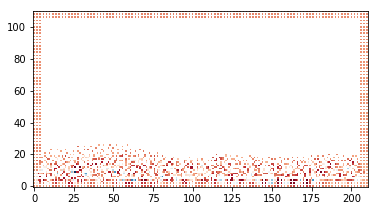

In [6]:
plt.imshow(Vx_all[-1], cmap='RdBu',origin='lower')

# 3. Peak-time plots: peak height & Vx & Vy & pressure vs. time

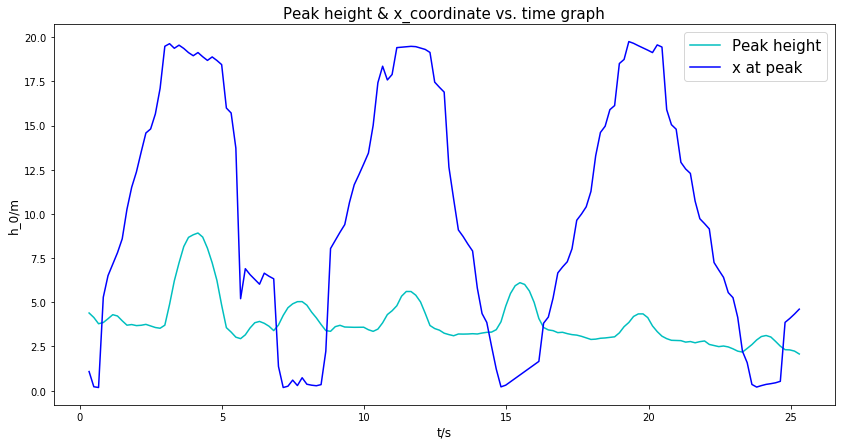

In [7]:
#t-peak graph
plt.figure(figsize=(14,7))
plt.xlabel('t/s',fontsize=12)
plt.ylabel('h_0/m',fontsize=12)
plt.title('Peak height & x_coordinate vs. time graph',fontsize=15)
plt.plot(no_list[2:], peak_h_list[2:], "c", label='Peak height')
plt.plot(no_list[2:], peak_x_list[2:], "b",label='x at peak')
plt.legend(fontsize=15)
plt.savefig('t-h_0&x_graph.jpg')

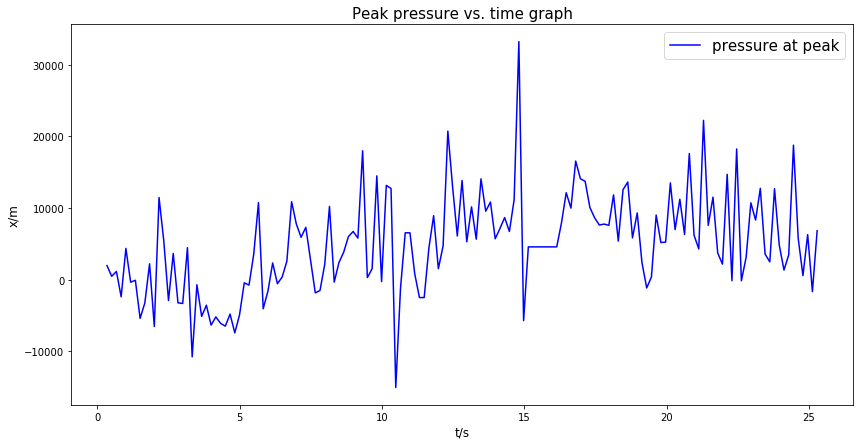

In [8]:
plt.figure(figsize=(14,7))
plt.xlabel('t/s',fontsize=12)
plt.ylabel('x/m',fontsize=12)
plt.title('Peak pressure vs. time graph',fontsize=15)
plt.plot(no_list[2:], peak_Pre_list[2:], "b",label='pressure at peak')
plt.legend(fontsize=15)
plt.savefig('t-P_graph.jpg')

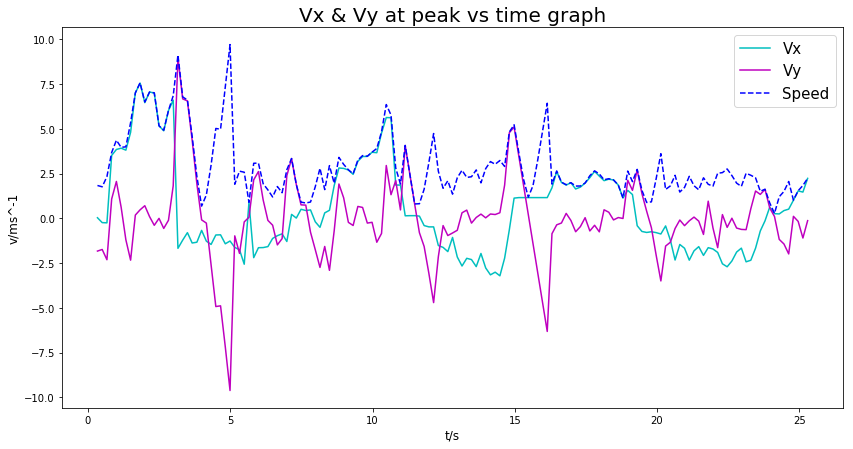

In [9]:
plt.figure(figsize=(14,7))
plt.xlabel('t/s',fontsize=12)
plt.ylabel('v/ms^-1',fontsize=12)
plt.title('Vx & Vy at peak vs time graph',fontsize=20)
plt.plot(no_list[2:], peak_Vx_list[2:], "c",label='Vx')
plt.plot(no_list[2:], peak_Vy_list[2:], "m",label='Vy')
plt.plot(no_list[2:], (np.array(peak_Vy_list[2:])**2+np.array(peak_Vx_list[2:])**2)**0.5, "b--",label='Speed')

plt.legend(fontsize=15)
plt.savefig('Vx&Vy&V-t_graph.jpg')

# 4. Animation creating - water parcel distribution & physical quantities

In [10]:
#4.1 general shape, variation undetectable, saved in /mdsave
def mdsave(itno):
    fig = plt.figure(figsize=(14,7))
    plt.xlabel('x, 0.1m/grid-point',fontsize=15)
    plt.ylabel('y, 0.1m/grid-point',fontsize=15)
    plt.title('Material distribution & peak indication',fontsize=20)
    plt.plot(x_coord_all[itno], y_coord_all[itno],"c*", label='Water parcels')
    plt.plot(x_coord_all[itno][peak_index_list[itno]],y_coord_all[itno][peak_index_list[itno]],"mo", label='Peak')
    plt.legend(fontsize=15, loc=2)
    plt.savefig('mdsave/md'+str(no_list[itno])+'.jpg') #need a directory 'mdsave'
    plt.close(fig)
    
filenames=[]
for i in range(items):
    #print(no_list[i])
    mdsave(i)
    filenames.append('mdsave/md'+str(no_list[i])+'.jpg')
    
with imageio.get_writer('animation.gif', mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

In [11]:
fig2 = plt.figure(figsize=(14,7))
plt.title('Material distribution over time')
plt.xlabel('x gridpoints ('+str(step)+'m/grid-point)')
plt.ylabel('y gridpoints('+str(step)+'m/grid-point)')
ims_md = []
for i in range(items):
    #im1=plt.plot(x_coord_all[i], y_coord_all[i],"c*", label='Water parcels')
    im2=plt.plot(x_coord_all[i], y_coord_all[i],"c*", label='Water parcels')
    ims_md.append(im2)
plt.close(fig2)
immd_ani = anim.ArtistAnimation(fig2, ims_md, interval=50, blit=True)
HTML(immd_ani.to_jshtml())

In [12]:
#4.2
def create_animation_Vx(colormin,colormax,intervalms,step):
    fig = plt.figure(figsize=(10,5))
    plt.title('Vx evolution over time')
    plt.xlabel('x gridpoints ('+str(step)+'m/grid-point)')
    plt.ylabel('y gridpoints('+str(step)+'m/grid-point)')

    n = len(Vx_all)
    imgs = []
    for i in range(n):
        img = plt.imshow(Vx_all[i], cmap='RdBu_r',origin='lower',vmin=colormin,vmax=colormax)
        imgs.append([img])

    print('Finished plots for frames, building animation...')
    
    ani = anim.ArtistAnimation(fig, imgs, interval=intervalms, blit=True)

    plt.close(fig)  # prevent final frame plot from showing up inline below

    return ani

def create_animation_Vy(colormin,colormax,intervalms,step):
    fig = plt.figure(figsize=(10,5))
    plt.title('Vy evolution over time')
    plt.xlabel('x gridpoints ('+str(step)+'m/grid-point)')
    plt.ylabel('y gridpoints('+str(step)+'m/grid-point)')

    n = len(Vy_all)
    imgs = []
    for i in range(n):
        img = plt.imshow(Vy_all[i], cmap='RdBu_r',origin='lower',vmin=colormin,vmax=colormax)
        imgs.append([img])

    print('Finished plots for frames, building animation...')
    
    ani = anim.ArtistAnimation(fig, imgs, interval=intervalms, blit=True)

    plt.close(fig)  # prevent final frame plot from showing up inline below

    return ani

#4.3
def create_animation_Speed(colormin,colormax,intervalms,step):
    fig = plt.figure(figsize=(10,5))
    plt.title('Speed evolution over time')
    plt.xlabel('x gridpoints ('+str(step)+'m/grid-point)')
    plt.ylabel('y gridpoints('+str(step)+'m/grid-point)')

    n = len(Vy_all)
    imgs = []
    for i in range(n):
        img = plt.imshow((np.array(Vy_all[i])**2+np.array(Vx_all[i])**2)**0.5, 
                         cmap='RdBu_r',origin='lower',vmin=colormin,vmax=colormax)
        imgs.append([img])

    print('Finished plots for frames, building animation...')
    
    ani = anim.ArtistAnimation(fig, imgs, interval=intervalms, blit=True)

    plt.close(fig)  # prevent final frame plot from showing up inline below

    return ani

#4.4
def create_animation_Pre(colormin,colormax,intervalms,step):
    fig = plt.figure(figsize=(10,5))
    plt.title('Pressure evolution over time')
    plt.xlabel('x gridpoints ('+str(step)+'m/grid-point)')
    plt.ylabel('y gridpoints('+str(step)+'m/grid-point)')

    n = len(Pre_all)
    imgs = []
    for i in range(n):
        img = plt.imshow(Pre_all[i], cmap='RdBu_r',origin='lower',vmin=colormin,vmax=colormax)
        imgs.append([img])

    print('Finished plots for frames, building animation...')
    
    ani = anim.ArtistAnimation(fig, imgs, interval=intervalms, blit=True)
    
    plt.close(fig)  # prevent final frame plot from showing up inline below

    return ani

In [13]:
Vx_ani = create_animation_Vx(-0.05,0.05,50,step)
print('Preparing Vx_HTML (takes a little while...)')
HTML(Vx_ani.to_jshtml())

Finished plots for frames, building animation...
Preparing Vx_HTML (takes a little while...)


In [14]:
Vy_ani = create_animation_Vy(-0.05,0.05,50,step)
print('Preparing Vy_HTML (takes a little while...)')
HTML(Vy_ani.to_jshtml())

Finished plots for frames, building animation...
Preparing Vy_HTML (takes a little while...)


In [15]:
Speed_ani = create_animation_Speed(-0.05,0.05,50,step)
print('Preparing Vy_HTML (takes a little while...)')
HTML(Speed_ani.to_jshtml())

Finished plots for frames, building animation...
Preparing Vy_HTML (takes a little while...)


In [16]:
Pre_ani = create_animation_Pre(-0.05,0.05,50,step)
print('Preparing Pressure_HTML (takes a little while...)')
HTML(Pre_ani.to_jshtml())

Finished plots for frames, building animation...
Preparing Pressure_HTML (takes a little while...)


# 5. Task 5 & sloshing interval

In [17]:
point={"x" : peak_x_list,
       "y" : peak_h_list,
       "t":no_list}
Point=pd.DataFrame(point)
Point=Point[(Point["y"]<(10-2.0*1.3*time_step))&(Point["x"]<(20-2.0*1.3*time_step))&(Point["x"]>0)&(Point["y"]>0)]
#print(Point)

t_left=[]
t_right=[]
left=Point.loc[Point['x']<1]
t=left.t.values.tolist()

diff=np.zeros(len(t)-1)
for i in range(1,len(t)-1):
    diff=t[i]-t[i-1]
    #print(t_l[i])
    #print(diff[i])
    if diff<0.1:
        continue
    else:
        t_left.append(t[i])
print(t_left)

right=Point.loc[Point['x']>19.5]
t1=right.t.values.tolist()

diff=np.zeros(len(t1)-1)
for i in range(1,len(t1)-1):
    diff=t1[i]-t1[i-1]
    #print(t_l[i])
    #print(diff[i])
    if diff<0.064996967:
        continue
    else:
        t_right.append(t1[i])
print(t_right)

[0.4992, 0.6656, 7.1552, 7.3216, 7.4879999999999995, 7.6544, 7.820799999999999, 7.9872, 8.153599999999999, 8.32, 8.4864, 14.8096, 14.975999999999999, 15.142399999999999, 15.3088, 15.4752, 23.6288, 23.795199999999998, 23.961599999999997, 24.128, 24.2944, 24.4608]
[3.4943999999999997, 19.3024, 19.468799999999998, 19.635199999999998]


In [18]:
#hand-pick period between adjacent data due to noise
intervals=[]    
i1=t_right[0]
intervals.append(i1)

i2=abs(mean(t_left[2:11])-mean(t_left[11:16]))/2. 
#divided by 2 bcz there are 2 peaks at the same time, one going left and the other right
intervals.append(i2)

i3=abs(mean(t_left[11:16])-mean(t_right[1:]))
intervals.append(i3)

i4=abs(t_left[16]-mean(t_right[1:]))
intervals.append(i4)
print(intervals)
print('average experimental period = ',mean(intervals)) #get the mean of experimental data

[3.4943999999999997, 3.6607999999999996, 4.3264, 4.16]
average experimental period =  3.9103999999999997


Theretical velocity & period
$$v_0=\sqrt{gh_0 \ }=4.90m/s$$
$$t=\frac{d}{v_0}=20/4.90=4.08s$$


theoretical speed =  4.9016622180643985
theoretical period =  4.080248517797242


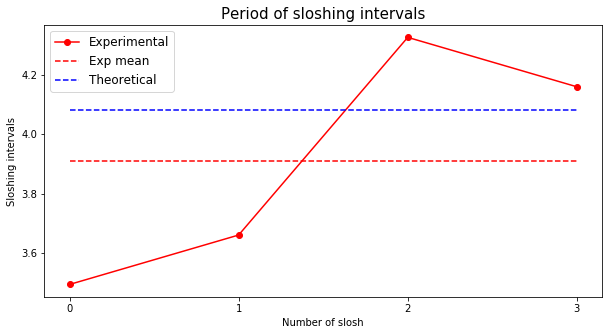

In [19]:
#sqrt(gh0)
g=9.80665
h0=5*3/20+2*17/20 #average depth, from initial plot
v0=np.sqrt(g*h0)
print('theoretical speed = ',v0)
print('theoretical period = ',20/v0)

fig=plt.figure(figsize=(10,5))
x=np.arange(0,4)
plt.title('Period of sloshing intervals', fontsize=15)
plt.xlabel('Number of slosh')
plt.ylabel('Sloshing intervals')
plt.ylim=(0,5)

my_x_ticks = np.arange(0, 4, 1)
# my_y_ticks = np.arange(0, 5, 1)
plt.xticks(my_x_ticks)
# plt.yticks(my_y_ticks)

plt.plot(x,intervals,c = 'r',marker = 'o', label='Experimental')
plt.plot([0,3],[mean(intervals),mean(intervals)],'r--', label='Exp mean')

plt.plot([0,3],[20/v0,20/v0],'b--', label='Theoretical')

plt.legend(fontsize=12)
plt.savefig('period.jpg')